In [1]:
import scanpy as sc
import pandas as pd
from pathlib import Path
import anndata as ad
import numpy as np
import os
import scvi

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

DPI = 300
FONTSIZE = 20  # 42

sc.settings.set_figure_params(
    scanpy=True, dpi=100, transparent=True, vector_friendly=True, dpi_save=DPI
)
from matplotlib import rcParams

rcParams["pdf.fonttype"] = 42

Global seed set to 0


In [2]:
DIR2SAVE = Path(
    "/data/BCI-CRC/nasrine/data/CRC/Metastatic_CRC_LM_dataset/subpopulations/TNKILC/CD4_C8_cluster"
)
DIR2SAVE.mkdir(parents=True, exist_ok=True)

In [3]:
FIG2SAVE = DIR2SAVE.joinpath("figures/")
FIG2SAVE.mkdir(parents=True, exist_ok=True)
# set the global variable: sc.settings.figdir to save all plots
sc.settings.figdir = FIG2SAVE

In [4]:
adata = sc.read_h5ad(
    DIR2SAVE.joinpath("Multiome_Che_Wu_CRC_LM_integrated_scvi_hvg_CD4_CD8.h5ad")
)

In [5]:
adata.obs.Cell_subtype.value_counts()

HSP                           870
No annotation                 857
CCL5+ CD4+ T cells            664
GIMAP7+ CD8+ T cells          632
CD4+ Naive T cells            570
Naive CD4 T                   227
CD52+ CD8+ T cells            181
ILC                           169
Exhausted CD8 T               157
HSP+ CD4+ T cells             113
EM CD8 T with B                85
LTB+ CD4+ T cells              75
FGFBP2+ GZMB+ CD8+ T cells     70
Naive CD8+ T cells             65
CCR6+ Th17                     61
XCL1+ CD8+ T cells             49
GZMK+ CD8+ T cells             47
NK1                            37
Th17                           34
gdT cells                      31
MAIT cells                     27
CTLA4+ CD8+ T cells            21
PDCD1+ CD4+ T cells            17
IFIT T                         16
GPR183+ CD4+ T cells           15
MKI67 T                        14
GZMB+ NK cells                 11
doublet B/myeloid              11
MAIT T                          7
NK2           

In [10]:
# neighbors were already computed using Harmony corrected PCs, so we perform clustering on that graph
sc.tl.leiden(adata, key_added="leiden_scVI", resolution=0.5, random_state=7)

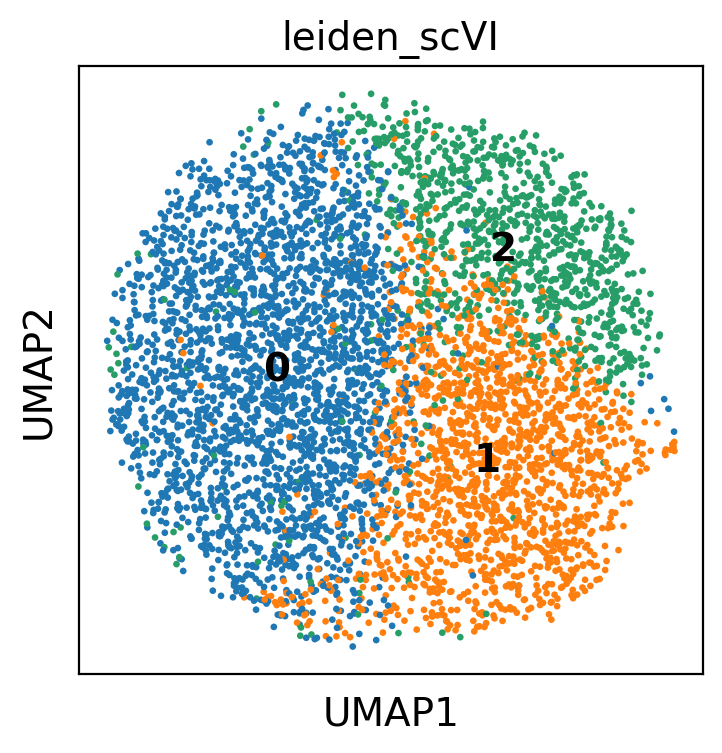

In [11]:
sc.pl.umap(
    adata,
    color="leiden_scVI",
    legend_loc="on data",
    save="CD4_CD8_clustering.pdf",
    show=True,
)

In [12]:
markers_T_general = {
    "T": ["TRAC"],
    "CD4": ["CD4"],
    "CD8": ["CD8A", "CD8B"],
    "Th": ["CD4", "IL7R", "CD40LG", "ANXA1"],
    "Tfh": ["ITM2A", "LPAR6", "PDCD1"],
    "Naïve CD4 T": [
        "CCR7",
        "SELL",
        "TCF7",
        "LEF1",
    ],
    "Effector CD8": [
        "CCL4",
        "CCL5",
        "GZMK",
        "GZMB",
        "PFN1",
        "GZMA",
        "GZMH",
        "NKG7",
    ],
    "Tmem": [
        "CCR7",
        "PTPRC",
        "ENPP1",
    ],  # https://panglaodb.se/markers.html?cell_type=%27T%20memory%20cells%27
    "Naive cytotoxic": ["CD8A", "CCR7", "SELL"],
}

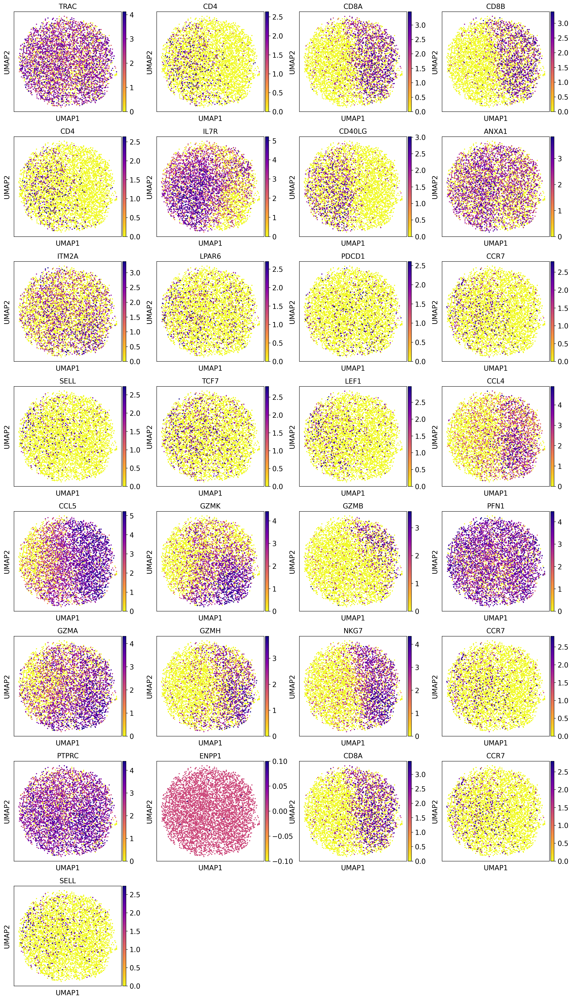

In [13]:
import itertools

# use log1p data stored in .raw
markers2plot = list(
    itertools.chain(*list(markers_T_general.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="CD4_CD8_markers.pdf",
    show=True,
)

### restrict markers to plot

In [14]:
markers_T_restrict = {
    "T": ["TRAC"],
    "CD4": ["CD4"],
    "CD8": ["CD8A", "CD8B"],
    "Th": ["CD4", "IL7R", "CD40LG", "ANXA1"],
    "Effector CD8": [
        "CCL4",
        "CCL5",
        "GZMK",
        "GZMB",
        "PFN1",
        "GZMA",
        "GZMH",
        "NKG7",
    ],
}

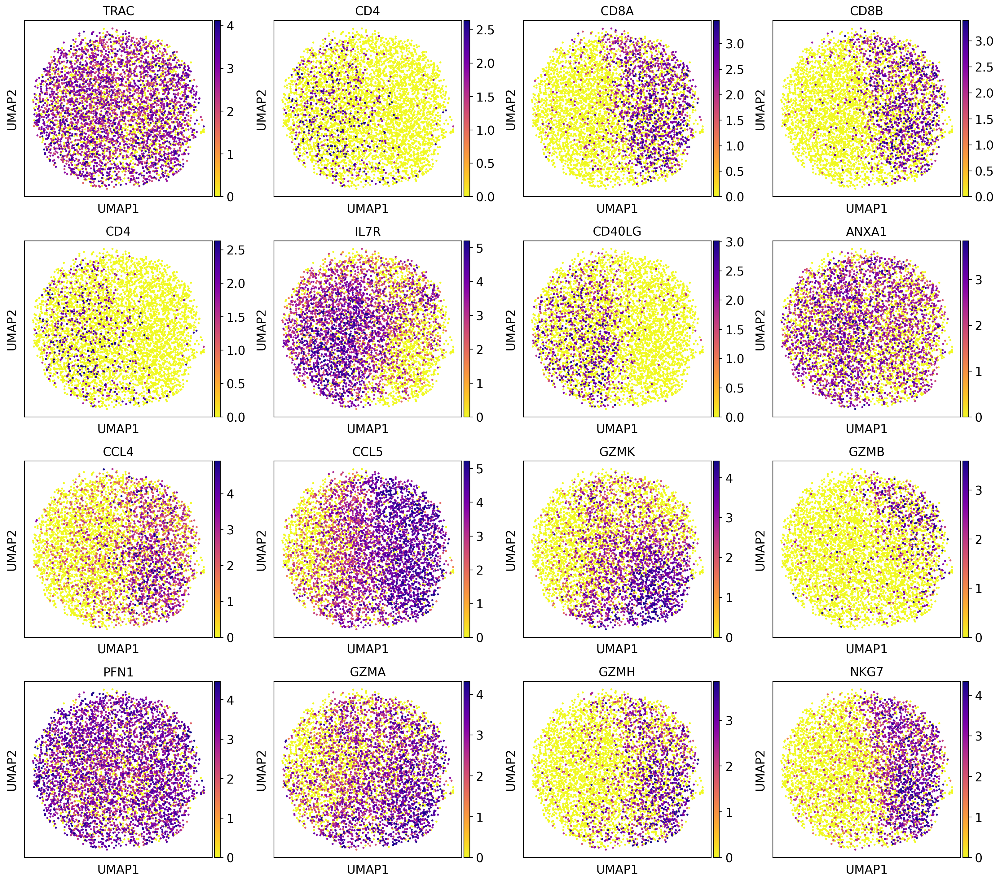

In [15]:
import itertools

# use log1p data stored in .raw
markers2plot = list(
    itertools.chain(*list(markers_T_restrict.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="CD4_CD8_markers_restricted.pdf",
    show=True,
)

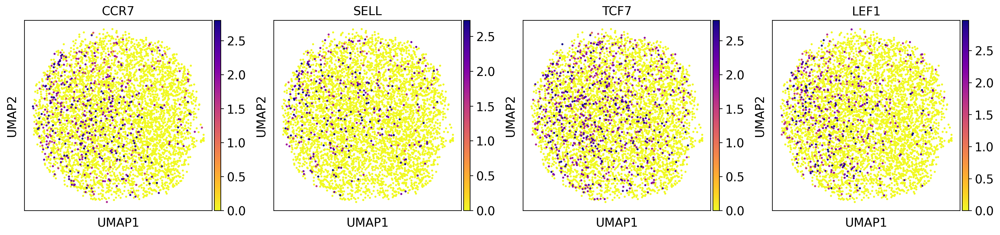

In [20]:
sc.pl.umap(
    adata,
    color=["CCR7", "SELL", "TCF7", "LEF1"],
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="CD4_Tn_markers.pdf",
    show=True,
)

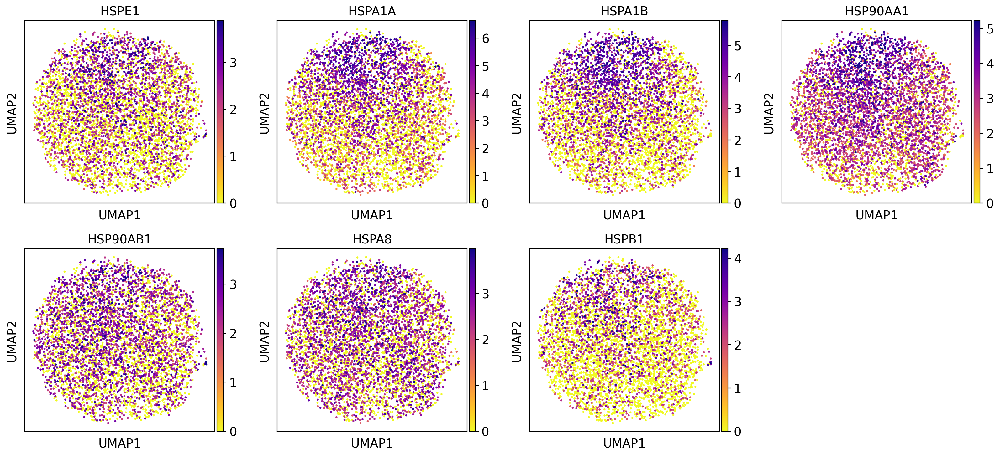

In [21]:
### markers for stress
# HSP
dissocation_markers_dict = {
    "shock protein": [
        "HSPE1",
        "HSPA1A",
        "HSPA1B",
        "HSP90AA1",
        "HSP90AB1",
        "HSPA8",
        "HSPB1",
    ],
    "immediate early genes": ["FOS", "JUN"],
}

sc.pl.umap(
    adata,
    color=dissocation_markers_dict["shock protein"],
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="plasma_r",
    save="general_HSPmarkers.pdf",
    show=True,
)

In [22]:
adata.obs[["leiden_scVI", "cell_source"]].groupby(["leiden_scVI", "cell_source"]).size()

leiden_scVI  cell_source
0            BCI-Nuclei      396
             Che-Cells       861
             Wu-Cells       1266
1            BCI-Nuclei      299
             Che-Cells       423
             Wu-Cells        882
2            BCI-Nuclei      162
             Che-Cells       357
             Wu-Cells        511
dtype: int64

### Annotation

In [27]:
old_to_new = {
    "0": "CD4 Th",
    "1": "CD8 Tem",
    "2": "CD8 Tem GZMB",
}

In [28]:
adata.obs["Annotation_scVI_detailed_CD4_CD8"] = (
    adata.obs["leiden_scVI"].map(old_to_new).astype("category")
)

In [29]:
adata.obs["Annotation_scVI_detailed_CD4_CD8"].cat.categories

Index(['CD4 Th', 'CD8 Tem', 'CD8 Tem GZMB'], dtype='object')

In [31]:
adata.uns["Annotation_scVI_detailed_CD4_CD8_colors"] = ["#fa9fb5", "#e31a1c", "#fc9272"]

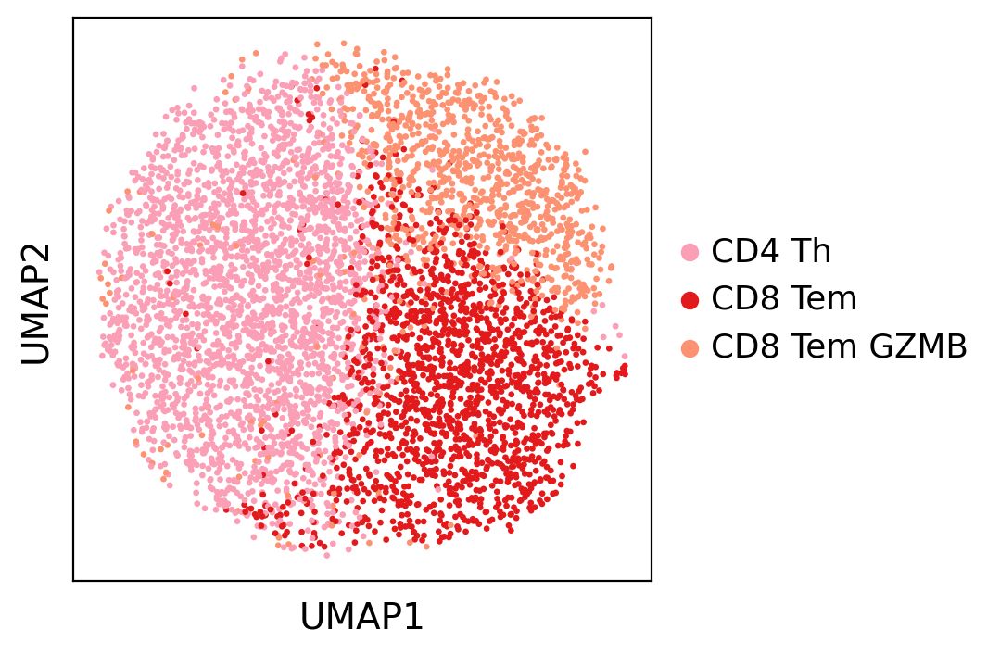

In [32]:
sc.pl.umap(
    adata,
    color="Annotation_scVI_detailed_CD4_CD8",
    show=True,
    legend_loc="right margin",
    save="annotations_CD4_Cd8.pdf",
    title="",
)

In [33]:
# write to file
adata.write(
    DIR2SAVE.joinpath(
        "Multiome_Che_Wu_CRC_LM_integrated_scvi_hvg_CD4_CD8_clustering.h5ad"
    )
)